# Studying Bit Error Rate changes while moving along a trajectory

In [1]:
import numpy as np
import os, time
import scipy
import matplotlib.pyplot as plt
import matplotlib
from IPython.display import HTML

from neoradium import DeepMimoData, TrjChannel, Carrier, Grid, AntennaPanel, random, PDSCH
from neoradium.utils import toDb, toLinear


In [2]:
# Replace this with the folder on your computer where you store DeepMIMO scenarios
dataFolder = "/data/RayTracing/DeepMIMO/Scenarios/V4/"
DeepMimoData.setScenariosPath(dataFolder)

# Create a DeepMimoData object
deepMimoData = DeepMimoData("asu_campus_3p5")
deepMimoData.print()


DeepMimoData Properties:
  Scenario:                   asu_campus_3p5
  Version:                    4.0.0a3
  UE Grid:                    rx_grid
  Grid Size:                  411 x 321
  Base Station:               BS (at [166. 104.  22.])
  Total Grid Points:          131,931
  UE Spacing:                 [1. 1.]
  UE bounds (xyMin, xyMax)    [-225.55 -160.17], [184.45 159.83]
  UE Height:                  1.50
  Carrier Frequency:          3.5 GHz
  Num. paths (Min, Avg, Max): 0, 6.21, 10
  Num. total blockage:        46774
  LOS percentage:             19.71%




Trajectory Properties:
  start (x,y,z):         (-164.55, 39.83, 1.50)
  No. of points:         8227
  curIdx:                0 (0.00%)
  curSpeed:              [10.64 10.64  0.  ]
  Total distance:        123.44 meters
  Total time:            8.226 seconds
  Average Speed:         15.006 m/s
  Carrier Frequency:     3.5 GHz
  Paths (Min, Avg, Max): 6, 8.99, 10
  Totally blocked:       0
  LOS percentage:        26.43%



(<Figure size 742.518x471.734 with 1 Axes>,
 <Axes: title={'center': 'Map of LOS/NLOS paths'}, xlabel='X', ylabel='Y'>)

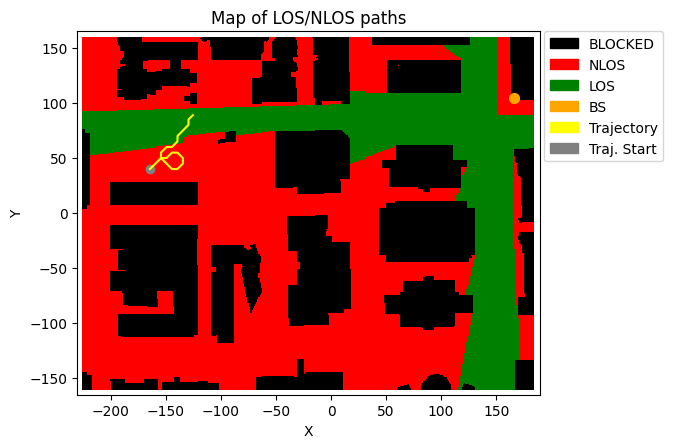

In [3]:
random.setSeed(123)                                 # Make results reproducible

# Create the carrier:
carrier = Carrier(startRb=0, numRbs=25, spacing=15) # Carrier with 25 Resource Blocks, 15KHz subcarrier spacing
bwp = carrier.curBwp                                # The only bandwidth part in the carrier

# Create a random trajectory at waking speed.
trajectory = deepMimoData.getRandomTrajectory(xyBounds=np.array([[-210, 40], [-120, 100]]),   # Traj. bounds
                                              segLen=5,               # Num grid points on shortest segment
                                              bwp=bwp,                # The bandwidth part
                                              trajLen=100,            # Number of grid points on trajectory
                                              speedMps=15)            # Speed in mps

trajectory.print()                                  # Print the trajectory information
deepMimoData.drawMap("LOS-NLOS", trajectory)        # Draw the Map with the trajectory

In [4]:
# Create a PDSCH object
pdsch = PDSCH(bwp, interleavingBundleSize=0, numLayers=1, nID=carrier.cellId, modulation="64QAM")
pdsch.setDMRS(prgSize=0, configType=2, additionalPos=2)     # Specify the DMRS configuration

channel = TrjChannel(bwp, trajectory,
                     txAntenna = AntennaPanel([2,4]),  # 8 TX antenna
                     txOrientation = [180,0,0],        # TX antenna pointing to the left
                     rxAntenna = AntennaPanel([1,2]),  # 2 RX antenna
                     seed = 123)
print(channel)

snrDbs = [-20,0]
chanEstMethods = ["Perfect", "LS"]
prevBer = {f"{chanEstMethod}{snrDb}": 0 for chanEstMethod in chanEstMethods for snrDb in snrDbs}
def getBER(channel, snrDbs, end):
    berInfo = {f"{chanEstMethod}{snrDb}": np.int32([0,0]) for chanEstMethod in chanEstMethods for snrDb in snrDbs}
    while channel.trajectory.curIdx < end:
        channelMatrix = channel.getChannelMatrix()                      # Get the channel matrix
        precoder = pdsch.getPrecodingMatrix(channelMatrix)              # Get the precoder matrix from PDSCH object
        for snrDb in snrDbs:
            for chanEstMethod in chanEstMethods:
                grid = pdsch.getGrid()                       # Create a resource grid already populated with DMRS 
                numBits = pdsch.getBitSizes(grid)[0]         # Actual number of bits available in the resource grid
                txBits = random.bits(numBits)                # Create random binary data
            
                # Now populate the resource grid with coded data. This includes QAM modulation and resource mapping.
                pdsch.populateGrid(grid, txBits)
            
                # Store the indexes of the PDSCH data in pdschIndexes to be used later.
                pdschIndexes = pdsch.getReIndexes(grid, "PDSCH")   
            
                precodedGrid = grid.precode(precoder)                           # Perform the precoding
                rxGrid = precodedGrid.applyChannel(channelMatrix)               # Apply the channel in frequency domain
                rxGrid = rxGrid.addNoise(snrDb=snrDb)                           # Add noise
            
                if chanEstMethod == "Perfect":                                  # Perfect Channel Estimation
                    estChannelMatrix = channelMatrix @ precoder[None,...]
                else:                                                           # LS + Interpolation Channel Estimation
                    estChannelMatrix, noiseEst = rxGrid.estimateChannelLS(pdsch.dmrs, polarInt=False, kernel='linear')
                
                eqGrid, llrScales = rxGrid.equalize(estChannelMatrix)           # Equalization
                rxBits = pdsch.getHardBitsFromGrid(eqGrid, pdschIndexes)[0]     # Demodulation
                bitErrors = np.abs(rxBits-txBits).sum()                        # Calculating number of bit errors
                berInfo[f"{chanEstMethod}{snrDb}"] += [bitErrors, numBits]
        channel.goNext()
    for chanEstMethod in chanEstMethods:
        for snrDb in snrDbs:
            k = f"{chanEstMethod}{snrDb}"
            berInfo[k] = berInfo[k][0]/berInfo[k][1]
    return berInfo

# A call back function that is called to draw up to three graphs below the animated trajectory
def handleGraph(request, ax, trajectory, points=None):
    if request=="Config":
        # Configure all graphs
        if len(ax)>0:
            ax[0].set_xlim(0,trajectory.numPoints)
            ax[0].set_ylim(0,.5)
            ax[0].set_title("BER (LS)")
            ax[0].grid()
        if len(ax)>1:
            ax[1].set_xlim(0,trajectory.numPoints)
            ax[1].set_ylim(0,.5)
            ax[1].set_title("BER (Perfect)")
            ax[1].grid()

    elif request=="Draw":
        # For Draw: ax is an array of `numGraphs` elements
        p0, p1 = points
        berInfo = getBER(channel, snrDbs, p1)
        if len(ax)>0:
            for i, snrDb in enumerate(snrDbs):
                k = f"LS{snrDb}"
                ax[0].plot([p0,p1], [prevBer[k],  berInfo[k]], ['orange','red'][i], markersize=1, label=f"SNR: {snrDb} dB")
                prevBer[k] = berInfo[k]
            if p0==0: ax[0].legend(fontsize=8)

        if len(ax)>1:
            for i, snrDb in enumerate(snrDbs):
                k = f"Perfect{snrDb}"
                ax[1].plot([p0,p1], [prevBer[k],  berInfo[k]], ['blue','black'][i], markersize=1, label=f"SNR: {snrDb} dB")
                prevBer[k] = berInfo[k]
            if p0==0: ax[1].legend(fontsize=8)

        print("\r Current Trajectory Point: %d (%d%%)    "%(trajectory.curIdx, 
                                                            trajectory.curIdx*100//trajectory.numPoints), end="")



TrjChannel Properties:
  carrierFreq:          3.5 GHz
  normalizeGains:       True
  normalizeOutput:      True
  normalizeDelays:      True
  xPolPower:            10.00 (dB)
  filterLen:            16 samples
  delayQuantSize:       64
  stopBandAtten:        80 dB
  dopplerShift:         175.6448069011776 Hz
  coherenceTime:        0.0024090788399960396 sec
  TX Antenna:
    Total Elements:     8
    spacing:            0.5𝜆, 0.5𝜆
    shape:              2 rows x 4 columns
    polarization:       |
    Orientation (𝛼,𝛃,𝛄): 180° 0° 0°
  RX Antenna:
    Total Elements:     2
    spacing:            0.5𝜆, 0.5𝜆
    shape:              1 rows x 2 columns
    polarization:       |
  Trajectory:
    start (x,y,z):         (-164.55, 39.83, 1.50)
    No. of points:         8227
    curIdx:                0 (0.00%)
    curSpeed:              [10.64 10.64  0.  ]
    Total distance:        123.44 meters
    Total time:            8.226 seconds
    Average Speed:         15.006 m/s
    Carrier

In [5]:
# Increase the animation memory limit to 100 MB
matplotlib.rcParams['animation.embed_limit'] = 100000000

# Now create the animation and display it in the following cell. This can take a while...
channel.restart()
anim = deepMimoData.animateTrajectory(trajectory, numGraphs=2, pointsPerFrame=20, graphCallback=handleGraph)
HTML(anim.to_jshtml())


 Current Trajectory Point: 8200 (99%)    